In [1]:
# Importing the 'drive' module from the 'google.colab' package
from google.colab import drive

# Mounting Google Drive to the '/content/drive' directory
drive.mount('/content/drive')

# Setting the root directory path for the dataset
root = '/content/drive/MyDrive/Colab Notebooks/FindIT/Dataset/'


Mounted at /content/drive


In [2]:
# Importing necessary libraries and modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import pickle

## 1. Dataset

### 1.1 Input Table

In [3]:
# Reading the CSV file 'test_set_features.csv' and storing the data in the 'test_feature' DataFrame
test_feature = pd.read_csv(root + 'test_set_features.csv')

# Reading the CSV file 'training_set_features.csv' and storing the data in the 'train_feature' DataFrame
train_feature = pd.read_csv(root + 'training_set_features.csv')


In [4]:
# Reading the CSV file 'training_set_labels.csv' and storing the data in the 'train_label' DataFrame
train_label = pd.read_csv(root+'training_set_labels.csv')

In [5]:
# Merging the 'train_label' and 'train_feature' DataFrames based on the 'respondent_id' column
# and storing the merged result in the 'df' DataFrame
df = train_label.merge(train_feature, on='respondent_id', how='left')


### 1.2 Table Setting

In [6]:
# Setting the maximum number of columns to display as None (unlimited)
pd.set_option('display.max_columns', None)

# Setting the maximum number of rows to display as None (unlimited)
pd.set_option('display.max_rows', None)


### 1.3 Table Summary

In [7]:
# Printing the number of rows and columns in the 'test_feature' DataFrame
print('test_set_feature:', test_feature.shape[0], "rows and", test_feature.shape[1], 'columns')

# Printing a separator line
print('---------------------------')

# Printing the number of rows and columns in the 'df' DataFrame
print('Dataset:', df.shape[0], "rows and", df.shape[1], 'columns')


test_set_feature: 26708 rows and 36 columns
---------------------------
Dataset: 26707 rows and 38 columns


## 2. Data Understanding

### 2.1 Data Checking

2.1.2 Showing Data Values

Test Feature Data Values

In [8]:
#Displaying the first few rows of the dataframe
test_feature.head()

,respondent_id,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,health_insurance,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,age_group,education,race,sex,income_poverty,marital_status,rent_or_own,employment_status,hhs_geo_region,census_msa,household_adults,household_children,employment_industry,employment_occupation
0,26707,2.0,2.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,1.0,1.0,5.0,1.0,1.0,35 - 44 Years,College Graduate,Hispanic,Female,"> $75,000",Not Married,Rent,Employed,mlyzmhmf,"MSA, Not Principle City",1.0,0.0,atmlpfrs,hfxkjkmi
1,26708,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,1.0,4.0,1.0,1.0,18 - 34 Years,12 Years,White,Male,Below Poverty,Not Married,Rent,Employed,bhuqouqj,Non-MSA,3.0,0.0,atmlpfrs,xqwwgdyp
2,26709,2.0,2.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,5.0,4.0,2.0,5.0,4.0,4.0,55 - 64 Years,College Graduate,White,Male,"> $75,000",Married,Own,Employed,lrircsnp,Non-MSA,1.0,0.0,nduyfdeo,pvmttkik
3,26710,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,4.0,2.0,2.0,4.0,4.0,2.0,65+ Years,12 Years,White,Female,"<= $75,000, Above Poverty",Married,Own,Not in Labor Force,lrircsnp,"MSA, Not Principle City",1.0,0.0,NaN,NaN
4,26711,3.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,5.0,2.0,4.0,4.0,4.0,2.0,35 - 44 Years,12 Years,Black,Female,"<= $75,000, Above Poverty",Not Married,Own,Employed,lzgpxyit,Non-MSA,0.0,1.0,fcxhlnwr,mxkfnird


DF Data Values

In [9]:
#Showing the first few rows in df(combination of label and feature).
df.head()

,respondent_id,h1n1_vaccine,seasonal_vaccine,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,health_insurance,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,age_group,education,race,sex,income_poverty,marital_status,rent_or_own,employment_status,hhs_geo_region,census_msa,household_adults,household_children,employment_industry,employment_occupation
0,0,0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,1.0,2.0,2.0,1.0,2.0,55 - 64 Years,< 12 Years,White,Female,Below Poverty,Not Married,Own,Not in Labor Force,oxchjgsf,Non-MSA,0.0,0.0,NaN,NaN
1,1,0,1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,4.0,4.0,4.0,2.0,4.0,35 - 44 Years,12 Years,White,Male,Below Poverty,Not Married,Rent,Employed,bhuqouqj,"MSA, Not Principle City",0.0,0.0,pxcmvdjn,xgwztkwe
2,2,0,0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,1.0,0.0,0.0,NaN,3.0,1.0,1.0,4.0,1.0,2.0,18 - 34 Years,College Graduate,White,Male,"<= $75,000, Above Poverty",Not Married,Own,Employed,qufhixun,"MSA, Not Principle City",2.0,0.0,rucpziij,xtkaffoo
3,3,0,1,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,NaN,3.0,3.0,5.0,5.0,4.0,1.0,65+ Years,12 Years,White,Female,Below Poverty,Not Married,Rent,Not in Labor Force,lrircsnp,"MSA, Principle City",0.0,0.0,NaN,NaN
4,4,0,0,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,3.0,3.0,2.0,3.0,1.0,4.0,45 - 54 Years,Some College,White,Female,"<= $75,000, Above Poverty",Married,Own,Employed,qufhixun,"MSA, Not Principle City",1.0,0.0,wxleyezf,emcorrxb


2.1.2 Displaying summary statistic

Test Feature Summary Statistic

In [10]:
# Computing and displaying descriptive statistics for the numerical columns in the 'test_feature' DataFrame
test_feature.describe()

,respondent_id,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,health_insurance,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children
count,26708.000000,26623.000000,26586.000000,26629.000000,26495.000000,26689.000000,26668.000000,26636.000000,26626.000000,26580.000000,24548.000000,24548.000000,25776.000000,25895.000000,25919.000000,14480.000000,26310.000000,26328.000000,26333.000000,26256.000000,26209.000000,26187.000000,26483.000000,26483.000000
mean,40060.500000,1.623145,1.266042,0.049645,0.729798,0.069279,0.826084,0.351517,0.337227,0.683747,0.222666,0.333551,0.281037,0.086310,0.111501,0.887914,3.844622,2.326838,2.360612,4.024832,2.708688,2.143392,0.894310,0.543745
std,7710.079831,0.902755,0.615617,0.217215,0.444072,0.253934,0.379045,0.477453,0.472772,0.465022,0.416044,0.471491,0.449514,0.280827,0.314758,0.315483,1.007570,1.275636,1.359413,1.083204,1.376045,1.339102,0.754244,0.935057
min,26707.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,33383.750000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,1.000000,1.000000,4.000000,2.000000,1.000000,0.000000,0.000000
50%,40060.500000,2.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,4.000000,2.000000,2.000000,4.000000,2.000000,2.000000,1.000000,0.000000
75%,46737.250000,2.000000,2.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,5.000000,4.000000,4.000000,5.000000,4.000000,4.000000,1.000000,1.000000
max,53414.000000,3.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,3.000000,3.000000


DF summary statistic

In [11]:
#Same as above
df.describe()

,respondent_id,h1n1_vaccine,seasonal_vaccine,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,health_insurance,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children
count,26707.000000,26707.000000,26707.000000,26615.000000,26591.000000,26636.000000,26499.000000,26688.000000,26665.000000,26620.00000,26625.000000,26579.000000,24547.000000,24547.000000,25736.000000,25887.000000,25903.000000,14433.00000,26316.000000,26319.000000,26312.000000,26245.000000,26193.000000,26170.000000,26458.000000,26458.000000
mean,13353.000000,0.212454,0.465608,1.618486,1.262532,0.048844,0.725612,0.068982,0.825614,0.35864,0.337315,0.677264,0.220312,0.329735,0.283261,0.082590,0.111918,0.87972,3.850623,2.342566,2.357670,4.025986,2.719162,2.118112,0.886499,0.534583
std,7709.791156,0.409052,0.498825,0.910311,0.618149,0.215545,0.446214,0.253429,0.379448,0.47961,0.472802,0.467531,0.414466,0.470126,0.450591,0.275266,0.315271,0.32530,1.007436,1.285539,1.362766,1.086565,1.385055,1.332950,0.753422,0.928173
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,6676.500000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.00000,3.000000,1.000000,1.000000,4.000000,2.000000,1.000000,0.000000,0.000000
50%,13353.000000,0.000000,0.000000,2.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.00000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.00000,4.000000,2.000000,2.000000,4.000000,2.000000,2.000000,1.000000,0.000000
75%,20029.500000,0.000000,1.000000,2.000000,2.000000,0.000000,1.000000,0.000000,1.000000,1.00000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.00000,5.000000,4.000000,4.000000,5.000000,4.000000,4.000000,1.000000,1.000000
max,26706.000000,1.000000,1.000000,3.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,3.000000,3.000000


2.1.3 Showing information about dataset

Test Feature info

In [12]:
# Displaying the concise summary of the 'test_feature' DataFrame, including column information and data types
test_feature.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26708 entries, 0 to 26707
Data columns (total 36 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   respondent_id                26708 non-null  int64  
 1   h1n1_concern                 26623 non-null  float64
 2   h1n1_knowledge               26586 non-null  float64
 3   behavioral_antiviral_meds    26629 non-null  float64
 4   behavioral_avoidance         26495 non-null  float64
 5   behavioral_face_mask         26689 non-null  float64
 6   behavioral_wash_hands        26668 non-null  float64
 7   behavioral_large_gatherings  26636 non-null  float64
 8   behavioral_outside_home      26626 non-null  float64
 9   behavioral_touch_face        26580 non-null  float64
 10  doctor_recc_h1n1             24548 non-null  float64
 11  doctor_recc_seasonal         24548 non-null  float64
 12  chronic_med_condition        25776 non-null  float64
 13  child_under_6_mo

DF info

In [13]:
#same as above
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26707 entries, 0 to 26706
Data columns (total 38 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   respondent_id                26707 non-null  int64  
 1   h1n1_vaccine                 26707 non-null  int64  
 2   seasonal_vaccine             26707 non-null  int64  
 3   h1n1_concern                 26615 non-null  float64
 4   h1n1_knowledge               26591 non-null  float64
 5   behavioral_antiviral_meds    26636 non-null  float64
 6   behavioral_avoidance         26499 non-null  float64
 7   behavioral_face_mask         26688 non-null  float64
 8   behavioral_wash_hands        26665 non-null  float64
 9   behavioral_large_gatherings  26620 non-null  float64
 10  behavioral_outside_home      26625 non-null  float64
 11  behavioral_touch_face        26579 non-null  float64
 12  doctor_recc_h1n1             24547 non-null  float64
 13  doctor_recc_seas

### 2.2 Exploratory Data Aalysist

Using Pie plot to visualize the total of people that vaccined

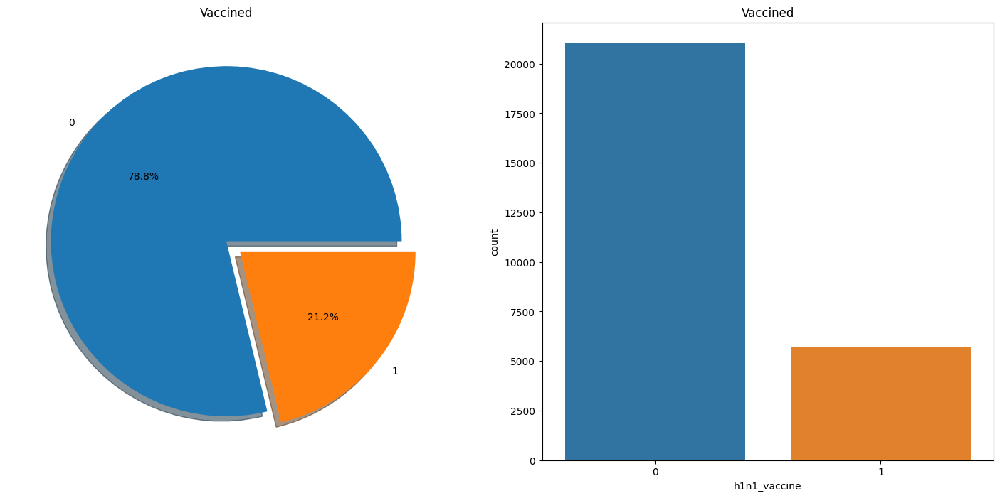

In [14]:
f,ax=plt.subplots(1,2,figsize=(18,8))
df['h1n1_vaccine'].value_counts().plot.pie(explode=[0,0.1],autopct='%1.1f%%',ax=ax[0],shadow=True)
ax[0].set_title('Vaccined')
ax[0].set_ylabel('')
sns.countplot(x=df['h1n1_vaccine'],ax=ax[1])
ax[1].set_title('Vaccined')
plt.show()

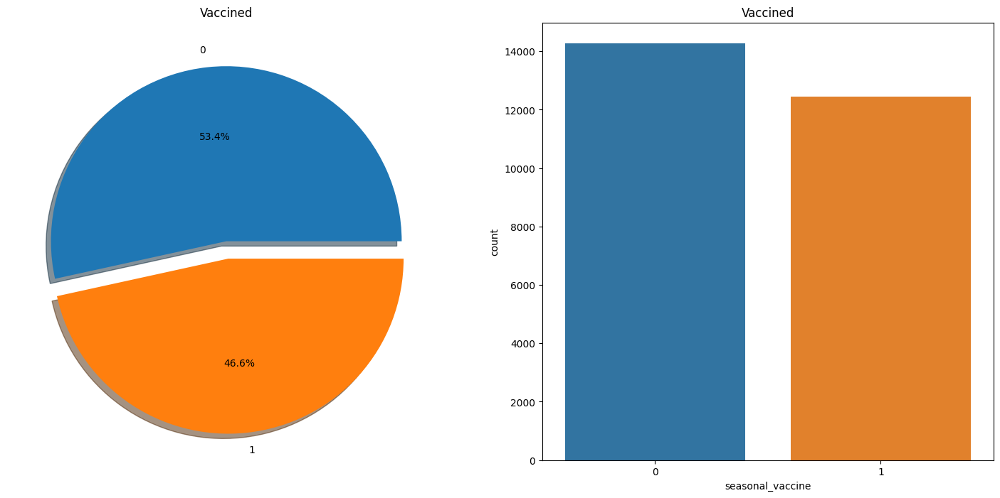

In [15]:
f,ax=plt.subplots(1,2,figsize=(18,8))
df['seasonal_vaccine'].value_counts().plot.pie(explode=[0,0.1],autopct='%1.1f%%',ax=ax[0],shadow=True)
ax[0].set_title('Vaccined')
ax[0].set_ylabel('')
sns.countplot(x=df['seasonal_vaccine'],ax=ax[1])
ax[1].set_title('Vaccined')
plt.show()

Using bar plot to calculate which gender got vaccinated the most

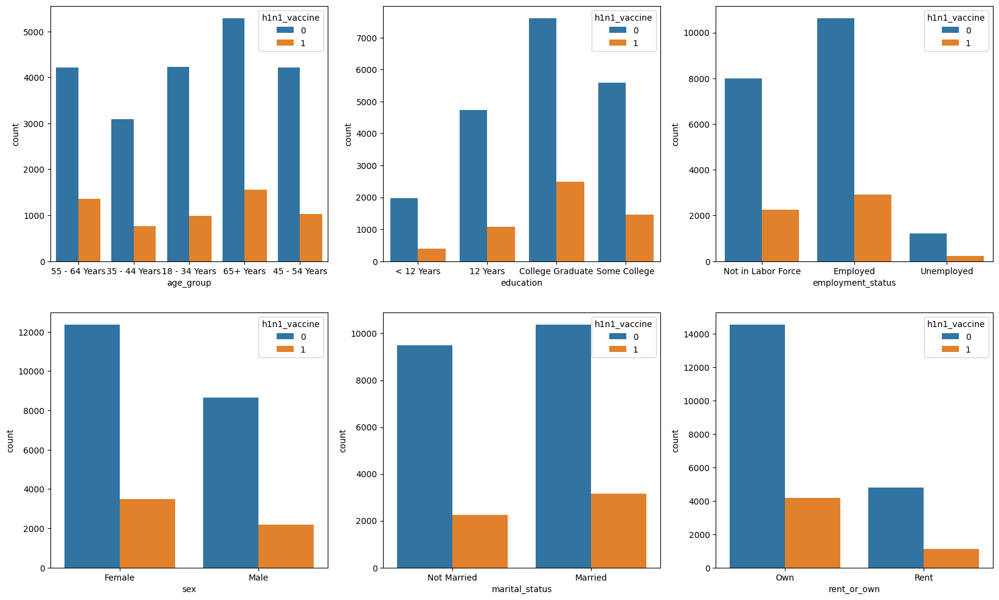

In [16]:
def plot_categorical_data_h1n1():
    fig,axes =plt.subplots(2,3,figsize = (20,12))

    sns.countplot(ax = axes[0,0], x='age_group', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[0,1], x='education', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[0,2], x='employment_status', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,0], x='sex', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,1], x='marital_status', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,2], x='rent_or_own', hue='h1n1_vaccine',data=df)
plot_categorical_data_h1n1()

Hasil dari source EDA dapat kami tampilkan bahwa orang lulus kuliah memiliki hasil yang tinggi daripada yang lulusan dibawahnya. Dan dari hasil tersebut kami dapatkan simpulkan bahwa orang yang berpendidikan dibawah 12 tahun memiliki kemauan yang rendah. Maka dari itu untuk mengatasi permasalahan tersebut kita harus memberikan edukasi untuk menyadarkan pentingnya vaksin h1n1.

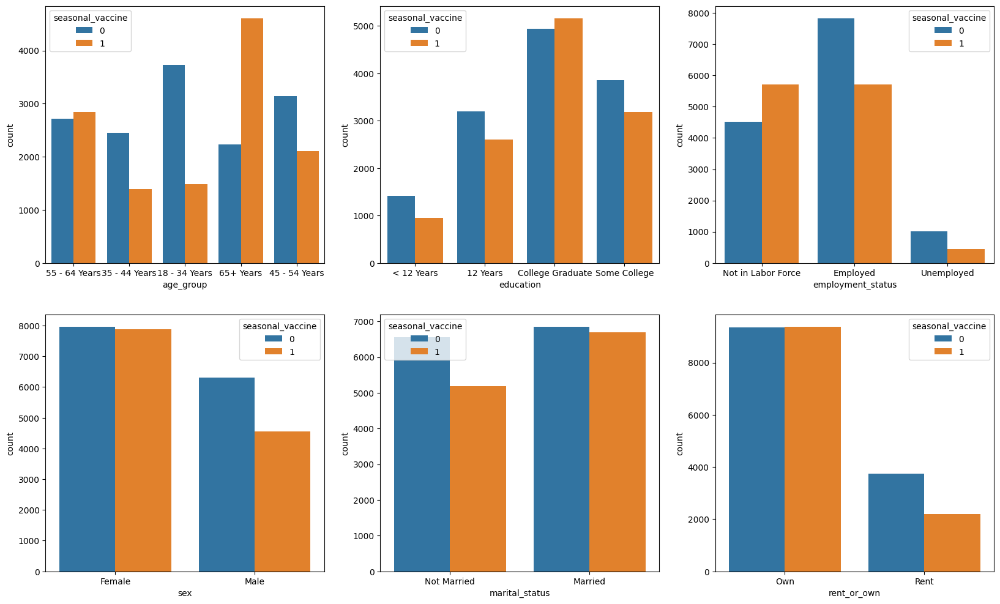

In [17]:
def plot_categorical_data_h1n1():
    fig,axes =plt.subplots(2,3,figsize = (20,12))

    sns.countplot(ax = axes[0,0], x='age_group', hue='seasonal_vaccine',data=df)
    sns.countplot(ax = axes[0,1], x='education', hue='seasonal_vaccine',data=df)
    sns.countplot(ax = axes[0,2], x='employment_status', hue='seasonal_vaccine',data=df)
    sns.countplot(ax = axes[1,0], x='sex', hue='seasonal_vaccine',data=df)
    sns.countplot(ax = axes[1,1], x='marital_status', hue='seasonal_vaccine',data=df)
    sns.countplot(ax = axes[1,2], x='rent_or_own', hue='seasonal_vaccine',data=df)
plot_categorical_data_h1n1()

Dari data yang ada ditunjukan bahwa orang yang menggunakna vaksin seasonal_vaccine dengan grafik terendah masuk pada usia 35-44 tahun. Selanjutnya data tersebut juga menunjukan bahwa orang memiliki pendidikan bawah 12 tahun dan pengangguran memiliki kemauan terendah untuk menggunakan vaksin jenis ini. 
Lalu untuk mengatasi permasalahan yang ada, maka salah satu opsinya adalah melakukan pendekatan-pendekatan ke generasi milenial khususnya bagi mereka yang masih pengangguran. Ada kemungkinan juga bahwa mereka yang tidak menggunakan vaksin ini karena kurang informasi sehingga diperlukan pendekatan.

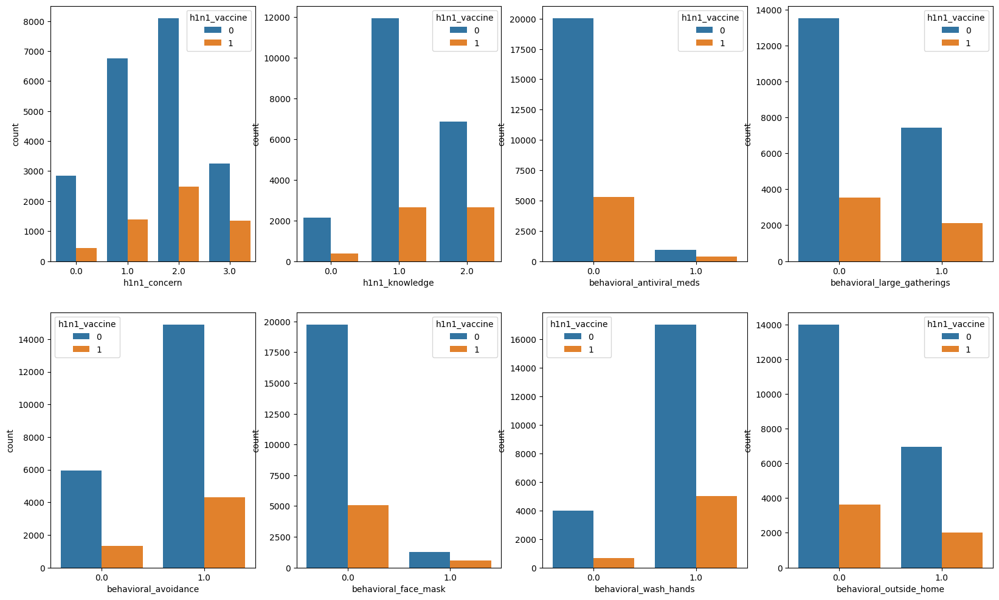

In [18]:
def plot_categorical_data_h1n1():
    fig,axes =plt.subplots(2,4,figsize = (20,12))

    sns.countplot(ax = axes[0,0], x='h1n1_concern', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[0,1], x='h1n1_knowledge', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[0,2], x='behavioral_antiviral_meds', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[0,3], x='behavioral_large_gatherings', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,0], x='behavioral_avoidance', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,1], x='behavioral_face_mask', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,2], x='behavioral_wash_hands', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,3], x='behavioral_outside_home', hue='h1n1_vaccine',data=df)
plot_categorical_data_h1n1()

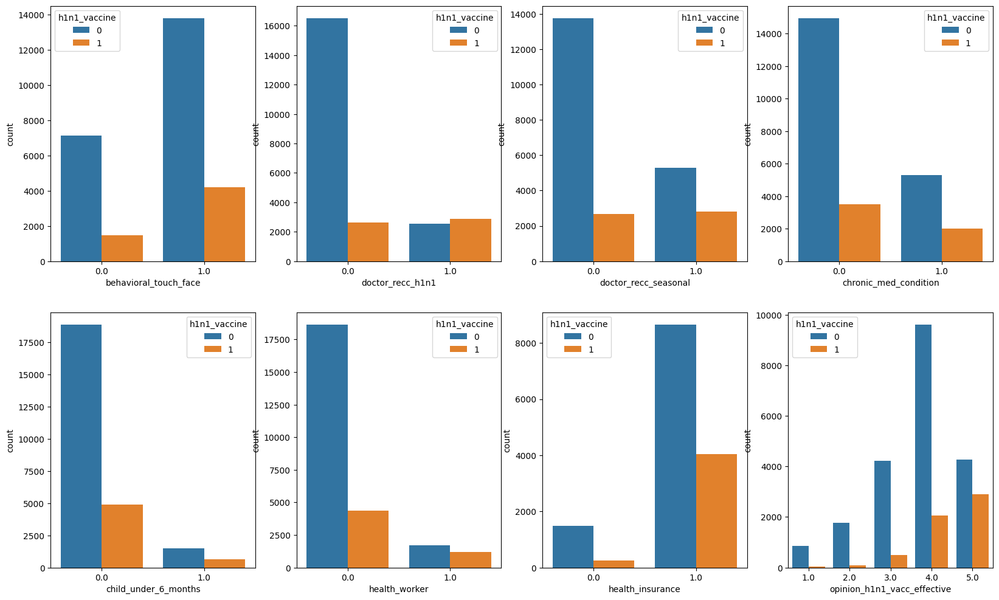

In [19]:
def plot_categorical_data_h1n1():
    fig,axes =plt.subplots(2,4,figsize = (20,12))

    sns.countplot(ax = axes[0,0], x='behavioral_touch_face', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[0,1], x='doctor_recc_h1n1', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[0,2], x='doctor_recc_seasonal', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[0,3], x='chronic_med_condition', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,0], x='child_under_6_months', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,1], x='health_worker', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,2], x='health_insurance', hue='h1n1_vaccine',data=df)
    sns.countplot(ax = axes[1,3], x='opinion_h1n1_vacc_effective', hue='h1n1_vaccine',data=df)
plot_categorical_data_h1n1()

Dari grafik yang ada di atas terdapat hasil bahwa orang yang memiliki asuransi kesehatan dan tidak peduli akan vaksin h1n1_vaccine memiliki grafik terendah untuk menggunakan vaksin tersebut. Maka dari itu, salah satu cara untuk meningkatkan grafik tersebut dengan cara melakukan vaksin ke pusat kesehatan masyarakat untuk dapat menjangkau orang orang yang belum memiliki asuransi.

## 3. Preprocessing Data

### 3.1 Handling Missing value

In [20]:
# Displaying the data types of each column in the 'df' DataFrame
df.dtypes

respondent_id                    int64
h1n1_vaccine                     int64
seasonal_vaccine                 int64
h1n1_concern                   float64
h1n1_knowledge                 float64
behavioral_antiviral_meds      float64
behavioral_avoidance           float64
behavioral_face_mask           float64
behavioral_wash_hands          float64
behavioral_large_gatherings    float64
behavioral_outside_home        float64
behavioral_touch_face          float64
doctor_recc_h1n1               float64
doctor_recc_seasonal           float64
chronic_med_condition          float64
child_under_6_months           float64
health_worker                  float64
health_insurance               float64
opinion_h1n1_vacc_effective    float64
opinion_h1n1_risk              float64
opinion_h1n1_sick_from_vacc    float64
opinion_seas_vacc_effective    float64
opinion_seas_risk              float64
opinion_seas_sick_from_vacc    float64
age_group                       object
education                

In [21]:
#displaying the first few rows of the dataframe
df.head()

,respondent_id,h1n1_vaccine,seasonal_vaccine,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,health_insurance,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,age_group,education,race,sex,income_poverty,marital_status,rent_or_own,employment_status,hhs_geo_region,census_msa,household_adults,household_children,employment_industry,employment_occupation
0,0,0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,1.0,2.0,2.0,1.0,2.0,55 - 64 Years,< 12 Years,White,Female,Below Poverty,Not Married,Own,Not in Labor Force,oxchjgsf,Non-MSA,0.0,0.0,NaN,NaN
1,1,0,1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,4.0,4.0,4.0,2.0,4.0,35 - 44 Years,12 Years,White,Male,Below Poverty,Not Married,Rent,Employed,bhuqouqj,"MSA, Not Principle City",0.0,0.0,pxcmvdjn,xgwztkwe
2,2,0,0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,1.0,0.0,0.0,NaN,3.0,1.0,1.0,4.0,1.0,2.0,18 - 34 Years,College Graduate,White,Male,"<= $75,000, Above Poverty",Not Married,Own,Employed,qufhixun,"MSA, Not Principle City",2.0,0.0,rucpziij,xtkaffoo
3,3,0,1,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,NaN,3.0,3.0,5.0,5.0,4.0,1.0,65+ Years,12 Years,White,Female,Below Poverty,Not Married,Rent,Not in Labor Force,lrircsnp,"MSA, Principle City",0.0,0.0,NaN,NaN
4,4,0,0,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,3.0,3.0,2.0,3.0,1.0,4.0,45 - 54 Years,Some College,White,Female,"<= $75,000, Above Poverty",Married,Own,Employed,qufhixun,"MSA, Not Principle City",1.0,0.0,wxleyezf,emcorrxb


In [22]:
# Calculating the total number of missing values for each column and sorting in descending order
total_missing = df.isnull().sum().sort_values(ascending=False)

# Calculating the percentage of missing values for each column
percent_1 = df.isnull().sum() / df.isnull().count() * 100

# Rounding the percentage values to one decimal place and sorting in descending order
percent_2 = (round(percent_1, 1)).sort_values(ascending=False)

# Creating a DataFrame 'missing_data' by combining the total missing values and percentage values
missing_data = pd.concat([total_missing, percent_2], axis=1, keys=['Total Missing', '%'])

# Resetting the index of 'missing_data' DataFrame and renaming the column
missing_data = missing_data.reset_index().rename(columns={'index': 'Column'})

# Showing the DataFrame 'missing_data'
missing_data

,Column,Total Missing,%
0,employment_occupation,13470,50.4
1,employment_industry,13330,49.9
2,health_insurance,12274,46.0
3,income_poverty,4423,16.6
4,doctor_recc_h1n1,2160,8.1
5,doctor_recc_seasonal,2160,8.1
6,rent_or_own,2042,7.6
7,employment_status,1463,5.5
8,marital_status,1408,5.3
9,education,1407,5.3


Menghapus kolom yang memiliki lebih dari 40% missing value

In [23]:
#Creates a copy of DataFrame 'df' as the DataFrame 'df1'
df1 = df.copy()

In [24]:
# Dropping specified columns ['employment_occupation', 'employment_industry', 'health_insurance'] from the 'df1' DataFrame
df1.drop(columns=['employment_occupation', 'employment_industry', 'health_insurance'], inplace=True)

In [25]:
#Show a tuple that represents the dimensions of the 'df1' DataFrame
df1.shape

(26707, 35)

Pisahkan kolom antara kolom dengan tipe data numerik dan categorical

In [26]:
# Creating a list of column names with 'object' data type (categorical columns)
categorical_cols = [col for col in df1.columns if df1[col].dtype == 'object']

# Creating a list of column names with data types other than 'object' (numeric columns)
numeric_cols = [col for col in df1.columns if df1[col].dtype != 'object']


In [27]:
# Creating a new DataFrame 'categorical_data' containing only the columns from 'df1' with 'object' data type
categorical_data = df1[categorical_cols]

# Creating a new DataFrame 'numeric_data' containing only the columns from 'df1' with data types other than 'object'
numeric_data = df1[numeric_cols]


In [28]:
categorical_data

,age_group,education,race,sex,income_poverty,marital_status,rent_or_own,employment_status,hhs_geo_region,census_msa
0,55 - 64 Years,< 12 Years,White,Female,Below Poverty,Not Married,Own,Not in Labor Force,oxchjgsf,Non-MSA
1,35 - 44 Years,12 Years,White,Male,Below Poverty,Not Married,Rent,Employed,bhuqouqj,"MSA, Not Principle City"
2,18 - 34 Years,College Graduate,White,Male,"<= $75,000, Above Poverty",Not Married,Own,Employed,qufhixun,"MSA, Not Principle City"
3,65+ Years,12 Years,White,Female,Below Poverty,Not Married,Rent,Not in Labor Force,lrircsnp,"MSA, Principle City"
4,45 - 54 Years,Some College,White,Female,"<= $75,000, Above Poverty",Married,Own,Employed,qufhixun,"MSA, Not Principle City"
5,65+ Years,12 Years,White,Male,"<= $75,000, Above Poverty",Married,Own,Employed,atmpeygn,"MSA, Principle City"
6,55 - 64 Years,< 12 Years,White,Male,"<= $75,000, Above Poverty",Not Married,Own,Employed,qufhixun,"MSA, Not Principle City"
7,45 - 54 Years,Some College,White,Female,"<= $75,000, Above Poverty",Married,Own,Employed,bhuqouqj,Non-MSA
8,45 - 54 Years,College Graduate,White,Male,"> $75,000",Married,Own,Employed,bhuqouqj,"MSA, Not Principle City"
9,55 - 64 Years,12 Years,White,Male,"<= $75,000, Above Poverty",Not Married,Own,Not in Labor Force,qufhixun,"MSA, Not Principle City"


In [29]:
#replaces the values in the 'age_group' column of the 'df1' DataFrame with corresponding categories
df1['age_group'] = df1['age_group'].replace({
    '18 - 34 Years': 'Muda',
    '35 - 44 Years': 'Cukup Dewasa',
    '45 - 54 Years': 'Dewasa',
    '55 - 64 Years': 'Cukup Tua',
    '65+ Years': 'Tua'
})

In [30]:
# Calculate the total number of missing values in each column of the 'categorical_data' DataFrame
categorical_data.isnull().sum()

age_group               0
education            1407
race                    0
sex                     0
income_poverty       4423
marital_status       1408
rent_or_own          2042
employment_status    1463
hhs_geo_region          0
census_msa              0
dtype: int64

In [31]:
# Fill missing values in the 'education' column with the mode (Most common numerical value)
categorical_data['education'] = categorical_data['education'].fillna(categorical_data['education'].mode()[0])

# Fill missing values in the 'income_poverty' column with the mode
categorical_data['income_poverty'] = categorical_data['income_poverty'].fillna(categorical_data['income_poverty'].mode()[0])

# Fill missing values in the 'marital_status' column with the mode
categorical_data['marital_status'] = categorical_data['marital_status'].fillna(categorical_data['marital_status'].mode()[0])

# Fill missing values in the 'employment_status' column with the mode
categorical_data['employment_status'] = categorical_data['employment_status'].fillna(categorical_data['employment_status'].mode()[0])


<ipython-input-31-08bd93614e06>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_data['education'] = categorical_data['education'].fillna(categorical_data['education'].mode()[0])
<ipython-input-31-08bd93614e06>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_data['income_poverty'] = categorical_data['income_poverty'].fillna(categorical_data['income_poverty'].mode()[0])
<ipython-input-31-08bd93614e06>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

In [32]:
#Same as above
categorical_data['rent_or_own'] = categorical_data['rent_or_own'].fillna(categorical_data['rent_or_own'].mode()[0])

<ipython-input-32-dc8bc3ccad70>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  categorical_data['rent_or_own'] = categorical_data['rent_or_own'].fillna(categorical_data['rent_or_own'].mode()[0])


In [33]:
#We've been here already....
categorical_data.isnull().sum()

age_group            0
education            0
race                 0
sex                  0
income_poverty       0
marital_status       0
rent_or_own          0
employment_status    0
hhs_geo_region       0
census_msa           0
dtype: int64

In [34]:
#Yeah, it's showing the first few rows.
numeric_data.head()

,respondent_id,h1n1_vaccine,seasonal_vaccine,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children
0,0,0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,2.0,2.0,1.0,2.0,0.0,0.0
1,1,0,1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,5.0,4.0,4.0,4.0,2.0,4.0,0.0,0.0
2,2,0,0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,1.0,0.0,0.0,3.0,1.0,1.0,4.0,1.0,2.0,2.0,0.0
3,3,0,1,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,3.0,3.0,5.0,5.0,4.0,1.0,0.0,0.0
4,4,0,0,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,3.0,2.0,3.0,1.0,4.0,1.0,0.0


In [35]:
#Same thing... total missing value
numeric_data.isnull().sum()

respondent_id                     0
h1n1_vaccine                      0
seasonal_vaccine                  0
h1n1_concern                     92
h1n1_knowledge                  116
behavioral_antiviral_meds        71
behavioral_avoidance            208
behavioral_face_mask             19
behavioral_wash_hands            42
behavioral_large_gatherings      87
behavioral_outside_home          82
behavioral_touch_face           128
doctor_recc_h1n1               2160
doctor_recc_seasonal           2160
chronic_med_condition           971
child_under_6_months            820
health_worker                   804
opinion_h1n1_vacc_effective     391
opinion_h1n1_risk               388
opinion_h1n1_sick_from_vacc     395
opinion_seas_vacc_effective     462
opinion_seas_risk               514
opinion_seas_sick_from_vacc     537
household_adults                249
household_children              249
dtype: int64

Handling numerical value

In [36]:
#Copy the DataFrame 'numeric_data' and put it in a new DataFrame 'num1'
num1 =numeric_data.copy()

In [37]:
#Same as above
num = numeric_data.copy()

In [38]:
# Identify columns in the 'num1' DataFrame that contain missing values
cols_with_missing = [col for col in num1.columns if num1[col].isnull().any()]

# Create a new DataFrame 'num_missing' containing columns with missing values
num_missing = num1[cols_with_missing]


In [39]:
#Anyone counting how much does we use this command already?
#Uh-uh, same thing, missing value... totals
num_missing.isnull().sum()

h1n1_concern                     92
h1n1_knowledge                  116
behavioral_antiviral_meds        71
behavioral_avoidance            208
behavioral_face_mask             19
behavioral_wash_hands            42
behavioral_large_gatherings      87
behavioral_outside_home          82
behavioral_touch_face           128
doctor_recc_h1n1               2160
doctor_recc_seasonal           2160
chronic_med_condition           971
child_under_6_months            820
health_worker                   804
opinion_h1n1_vacc_effective     391
opinion_h1n1_risk               388
opinion_h1n1_sick_from_vacc     395
opinion_seas_vacc_effective     462
opinion_seas_risk               514
opinion_seas_sick_from_vacc     537
household_adults                249
household_children              249
dtype: int64

Handling missing value numeric menggunakan simple imputer mean

In [40]:
# Import the SimpleImputer class from the sklearn.impute module
from sklearn.impute import SimpleImputer


In [41]:
# Create an instance of SimpleImputer with mean strategy to handle missing values
SI_mean = SimpleImputer(missing_values=np.nan, strategy='mean')

# Impute missing values in num_missing using the mean strategy
num_missing_new = SI_mean.fit_transform(num_missing)

# Convert the imputed values back to a DataFrame with original column names and index
num_missing_new = pd.DataFrame(num_missing_new, columns=num_missing.columns, index=num_missing.index)

# Print the summary information of the num_missing_new DataFrame
num_missing_new.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 26707 entries, 0 to 26706
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   h1n1_concern                 26707 non-null  float64
 1   h1n1_knowledge               26707 non-null  float64
 2   behavioral_antiviral_meds    26707 non-null  float64
 3   behavioral_avoidance         26707 non-null  float64
 4   behavioral_face_mask         26707 non-null  float64
 5   behavioral_wash_hands        26707 non-null  float64
 6   behavioral_large_gatherings  26707 non-null  float64
 7   behavioral_outside_home      26707 non-null  float64
 8   behavioral_touch_face        26707 non-null  float64
 9   doctor_recc_h1n1             26707 non-null  float64
 10  doctor_recc_seasonal         26707 non-null  float64
 11  chronic_med_condition        26707 non-null  float64
 12  child_under_6_months         26707 non-null  float64
 13  health_worker   

handling missing value menggunakan simple imputer median

In [42]:
SI_mean = SimpleImputer(missing_values = np.nan,strategy='median')
num_missing_new_1 = SI_mean.fit_transform(num_missing)
num_missing_new_1 = pd.DataFrame(num_missing_new_1,columns=num_missing.columns,index=num_missing.index)
num_missing_new_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26707 entries, 0 to 26706
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   h1n1_concern                 26707 non-null  float64
 1   h1n1_knowledge               26707 non-null  float64
 2   behavioral_antiviral_meds    26707 non-null  float64
 3   behavioral_avoidance         26707 non-null  float64
 4   behavioral_face_mask         26707 non-null  float64
 5   behavioral_wash_hands        26707 non-null  float64
 6   behavioral_large_gatherings  26707 non-null  float64
 7   behavioral_outside_home      26707 non-null  float64
 8   behavioral_touch_face        26707 non-null  float64
 9   doctor_recc_h1n1             26707 non-null  float64
 10  doctor_recc_seasonal         26707 non-null  float64
 11  chronic_med_condition        26707 non-null  float64
 12  child_under_6_months         26707 non-null  float64
 13  health_worker   

In [43]:
SI_mean = SimpleImputer(missing_values = np.nan,strategy='most_frequent')
num_missing_new_1 = SI_mean.fit_transform(num_missing)
num_missing_new_1 = pd.DataFrame(num_missing_new_1,columns=num_missing.columns,index=num_missing.index)
num_missing_new_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26707 entries, 0 to 26706
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   h1n1_concern                 26707 non-null  float64
 1   h1n1_knowledge               26707 non-null  float64
 2   behavioral_antiviral_meds    26707 non-null  float64
 3   behavioral_avoidance         26707 non-null  float64
 4   behavioral_face_mask         26707 non-null  float64
 5   behavioral_wash_hands        26707 non-null  float64
 6   behavioral_large_gatherings  26707 non-null  float64
 7   behavioral_outside_home      26707 non-null  float64
 8   behavioral_touch_face        26707 non-null  float64
 9   doctor_recc_h1n1             26707 non-null  float64
 10  doctor_recc_seasonal         26707 non-null  float64
 11  chronic_med_condition        26707 non-null  float64
 12  child_under_6_months         26707 non-null  float64
 13  health_worker   

<ipython-input-44-26cd2a18c257>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


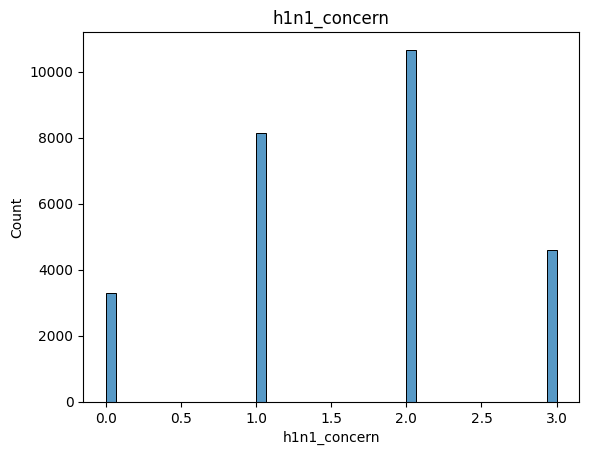

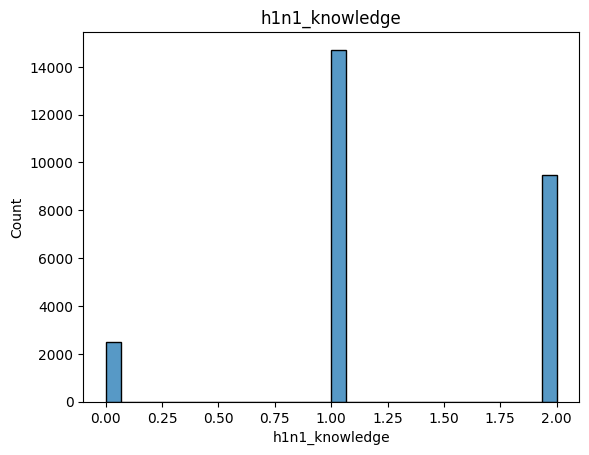

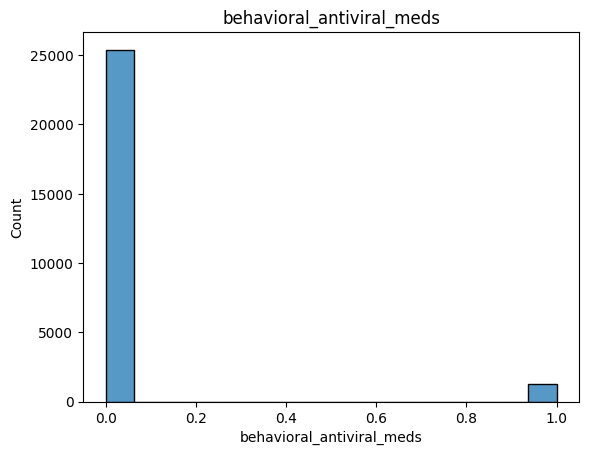

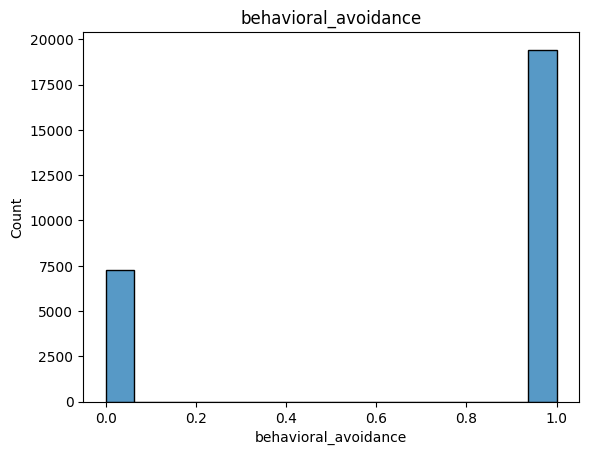

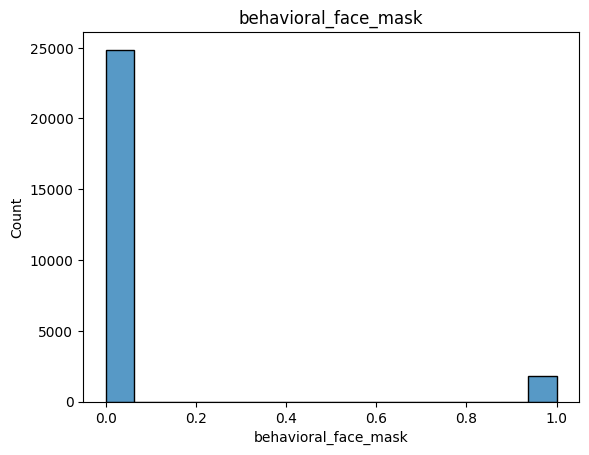

...

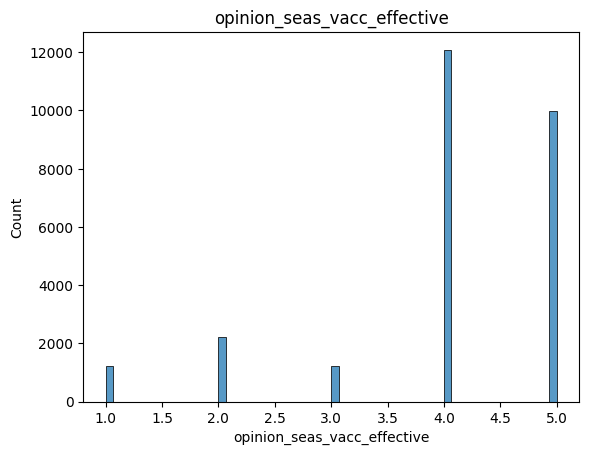

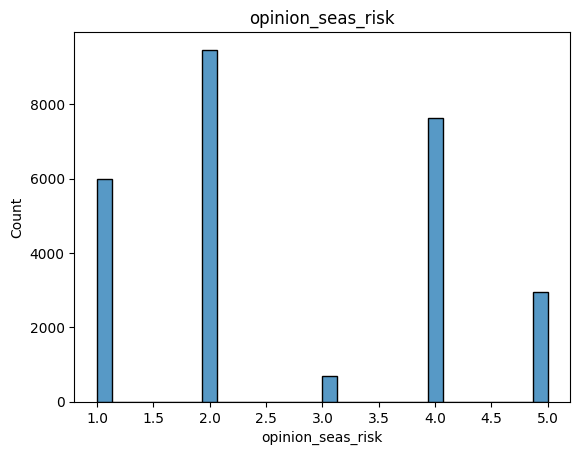

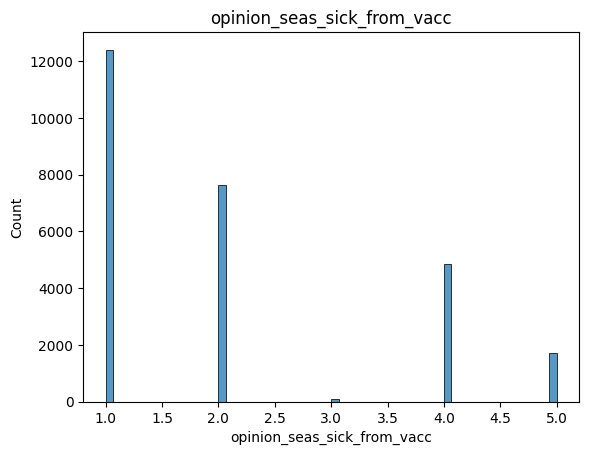

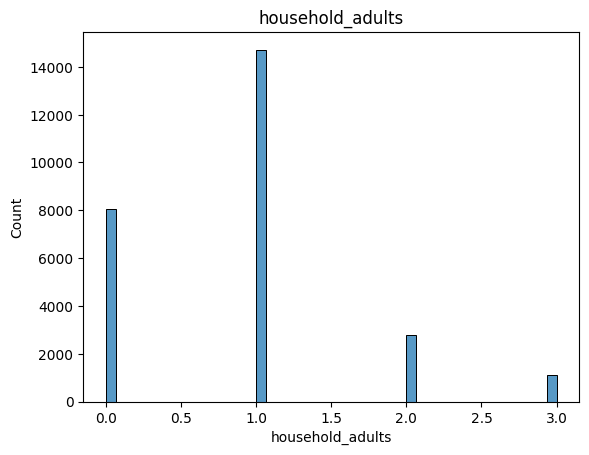

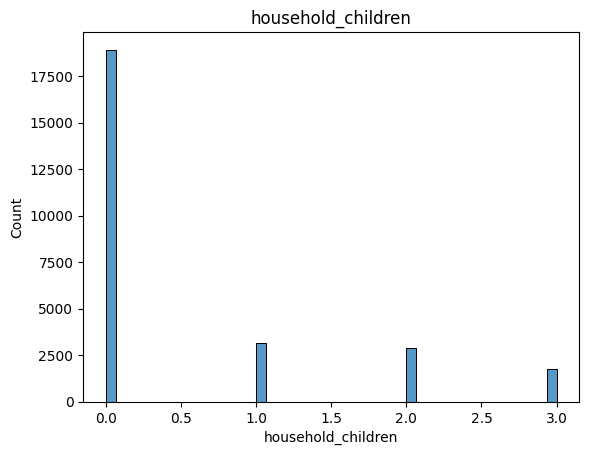

In [44]:
for i in num_missing:
    plt.figure()
    sns.histplot(x = i, data = num_missing_new_1)
    plt.title(i)

<ipython-input-45-ab41a4cfea18>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


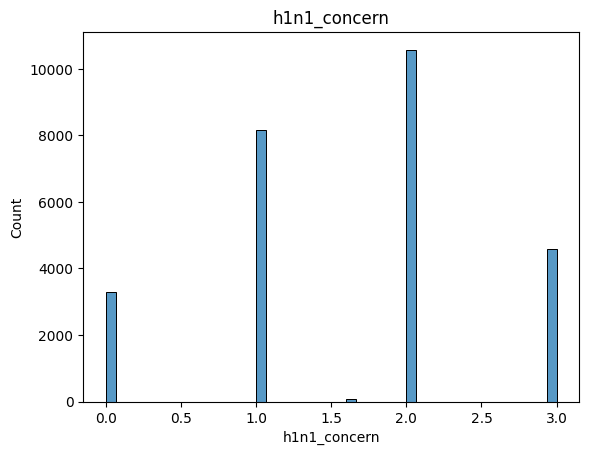

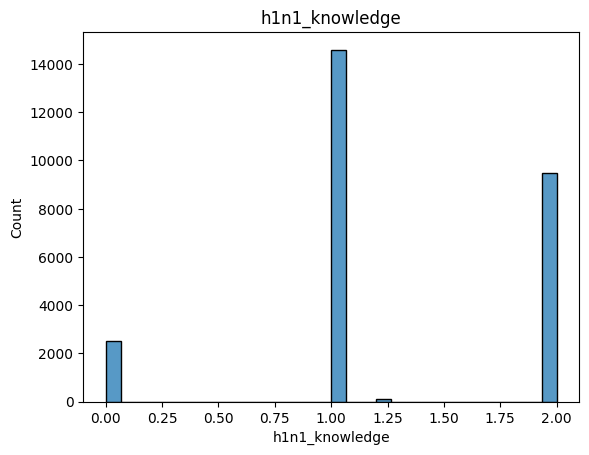

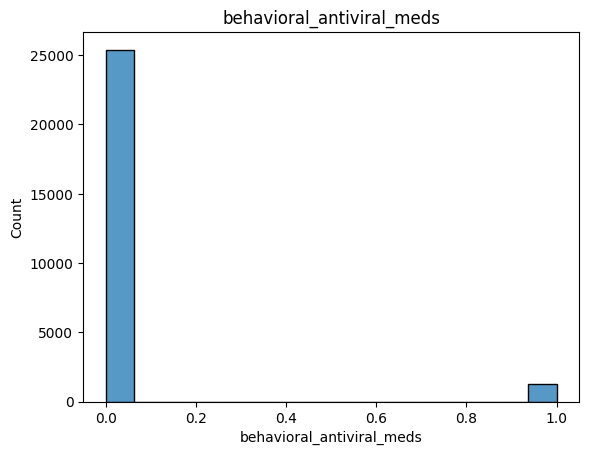

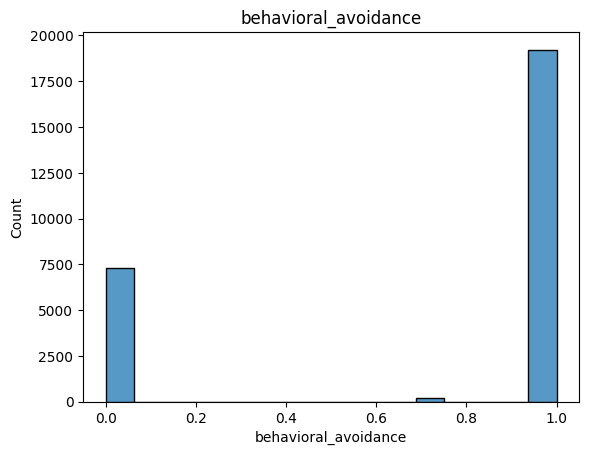

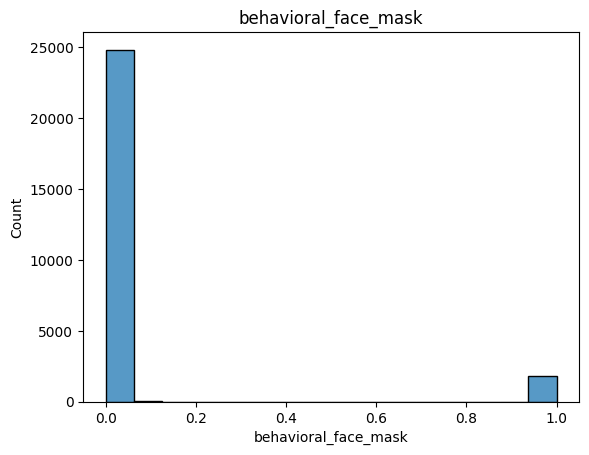

...

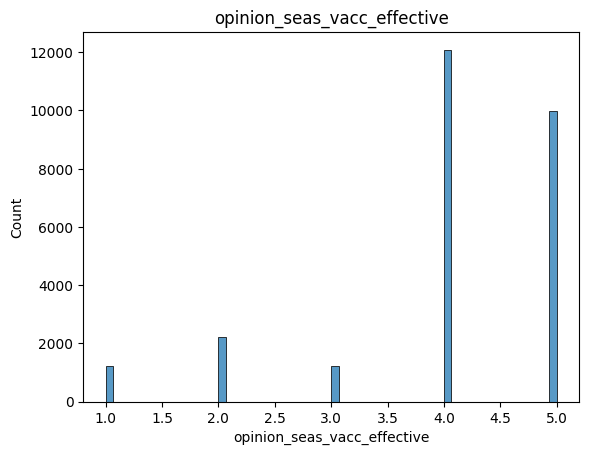

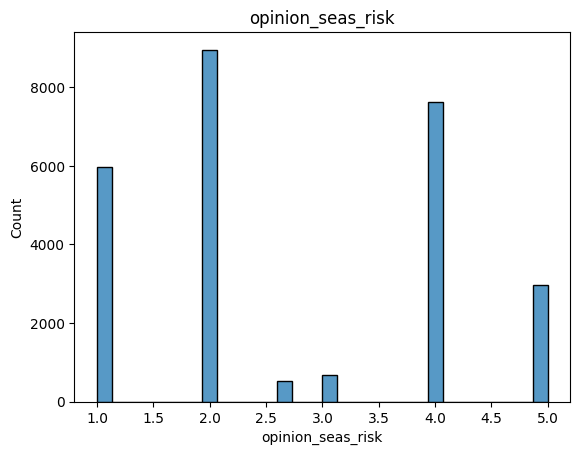

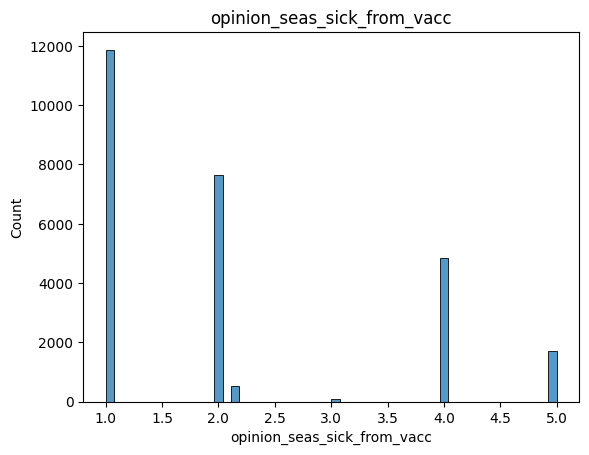

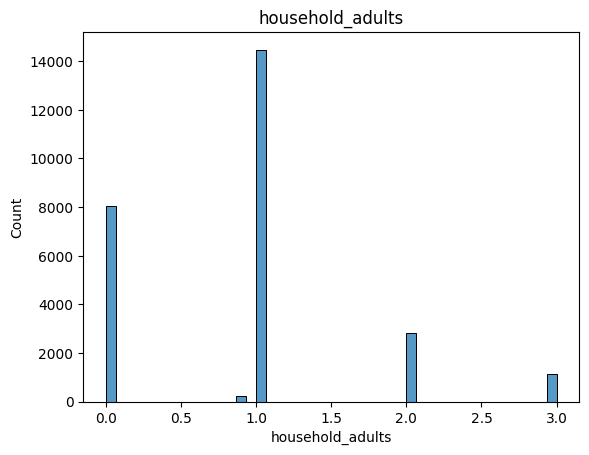

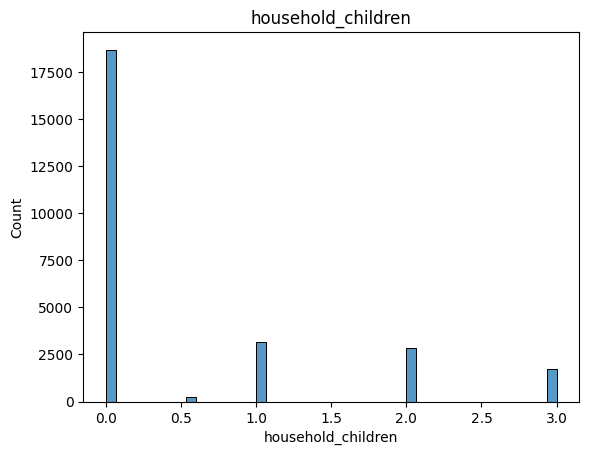

In [45]:
for i in num_missing:
    plt.figure()
    sns.histplot(x = i, data = num_missing_new)
    plt.title(i)

handling Missing value menggunakan median


In [46]:
cols_with_missing = [col for col in num.columns if num[col].isnull().any()]
missing_num = num[cols_with_missing]

In [47]:
cols_without_missing = [col for col in num.columns if not num[col].isnull().any()]
df_no_missing = df[cols_without_missing]

In [48]:
missing_num.isnull().sum()

h1n1_concern                     92
h1n1_knowledge                  116
behavioral_antiviral_meds        71
behavioral_avoidance            208
behavioral_face_mask             19
behavioral_wash_hands            42
behavioral_large_gatherings      87
behavioral_outside_home          82
behavioral_touch_face           128
doctor_recc_h1n1               2160
doctor_recc_seasonal           2160
chronic_med_condition           971
child_under_6_months            820
health_worker                   804
opinion_h1n1_vacc_effective     391
opinion_h1n1_risk               388
opinion_h1n1_sick_from_vacc     395
opinion_seas_vacc_effective     462
opinion_seas_risk               514
opinion_seas_sick_from_vacc     537
household_adults                249
household_children              249
dtype: int64

In [49]:
missing_num['doctor_recc_seasonal'] = numeric_data['doctor_recc_seasonal'].fillna(numeric_data['doctor_recc_seasonal'].median())
missing_num['h1n1_concern'] = numeric_data['h1n1_concern'].fillna(numeric_data['h1n1_concern'].median())
missing_num['behavioral_antiviral_meds'] = numeric_data['behavioral_antiviral_meds'].fillna(numeric_data['behavioral_antiviral_meds'].median())
missing_num['behavioral_avoidance'] = numeric_data['behavioral_avoidance'].fillna(numeric_data['behavioral_avoidance'].median())
missing_num['behavioral_face_mask'] = numeric_data['behavioral_face_mask'].fillna(numeric_data['behavioral_face_mask'].median())
missing_num['behavioral_wash_hands'] = numeric_data['behavioral_wash_hands'].fillna(numeric_data['behavioral_wash_hands'].median())
missing_num['behavioral_outside_home'] = numeric_data['behavioral_outside_home'].fillna(numeric_data['behavioral_outside_home'].median())
missing_num['behavioral_large_gatherings'] = numeric_data['behavioral_large_gatherings'].fillna(numeric_data['behavioral_large_gatherings'].median())
missing_num['behavioral_touch_face'] = numeric_data['behavioral_touch_face'].fillna(numeric_data['behavioral_touch_face'].median())
missing_num['doctor_recc_h1n1'] = numeric_data['doctor_recc_h1n1'].fillna(numeric_data['doctor_recc_h1n1'].median())
missing_num['chronic_med_condition'] = numeric_data['chronic_med_condition'].fillna(numeric_data['chronic_med_condition'].median())
missing_num['child_under_6_months'] = numeric_data['child_under_6_months'].fillna(numeric_data['child_under_6_months'].median())
missing_num['health_worker'] = numeric_data['health_worker'].fillna(numeric_data['health_worker'].median())
missing_num['opinion_h1n1_vacc_effective'] = numeric_data['opinion_h1n1_vacc_effective'].fillna(numeric_data['opinion_h1n1_vacc_effective'].median())
missing_num['opinion_h1n1_risk'] = numeric_data['opinion_h1n1_risk'].fillna(numeric_data['opinion_h1n1_risk'].median())
missing_num['opinion_h1n1_sick_from_vacc'] = numeric_data['opinion_h1n1_sick_from_vacc'].fillna(numeric_data['opinion_h1n1_sick_from_vacc'].median())
missing_num['opinion_seas_vacc_effective'] = numeric_data['opinion_seas_vacc_effective'].fillna(numeric_data['opinion_seas_vacc_effective'].median())
missing_num['opinion_seas_risk'] = numeric_data['opinion_seas_risk'].fillna(numeric_data['opinion_seas_risk'].median())
missing_num['opinion_seas_sick_from_vacc'] = numeric_data['opinion_seas_sick_from_vacc'].fillna(numeric_data['opinion_seas_sick_from_vacc'].median())
missing_num['household_adults'] = numeric_data['household_adults'].fillna(numeric_data['household_adults'].median())
missing_num['household_children'] = numeric_data['household_children'].fillna(numeric_data['household_children'].median())
missing_num['h1n1_knowledge'] = numeric_data['h1n1_knowledge'].fillna(numeric_data['h1n1_knowledge'].median())

<ipython-input-49-da356076a248>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  missing_num['doctor_recc_seasonal'] = numeric_data['doctor_recc_seasonal'].fillna(numeric_data['doctor_recc_seasonal'].median())
<ipython-input-49-da356076a248>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  missing_num['h1n1_concern'] = numeric_data['h1n1_concern'].fillna(numeric_data['h1n1_concern'].median())
<ipython-input-49-da356076a248>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

<ipython-input-50-0873fd95f940>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


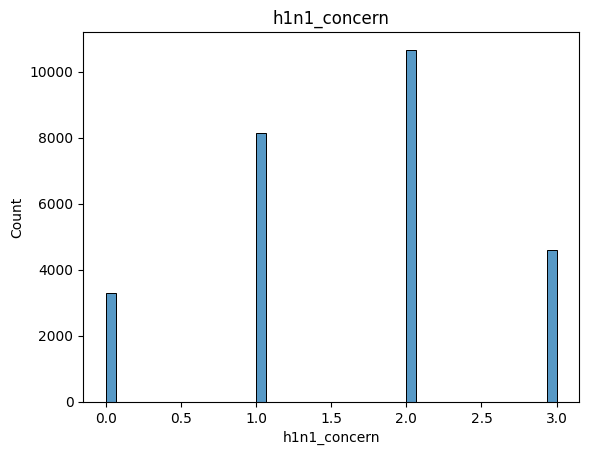

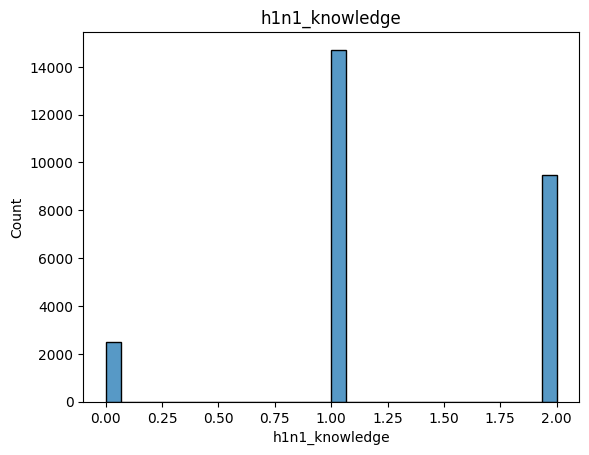

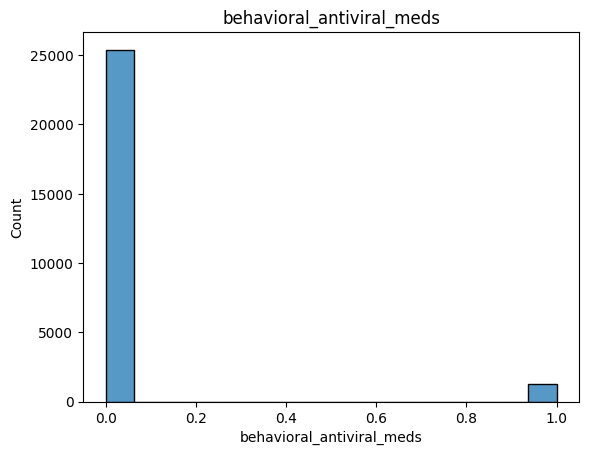

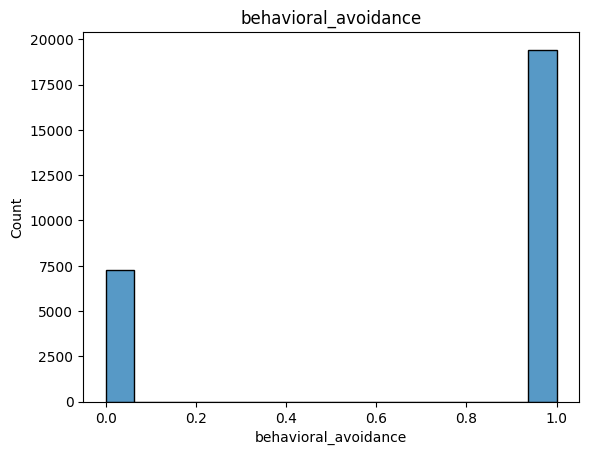

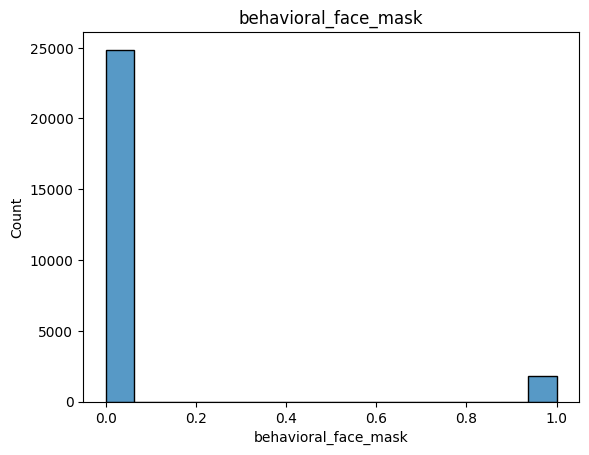

...

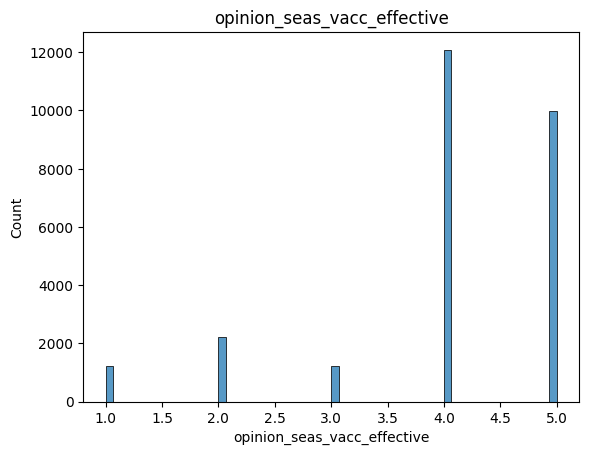

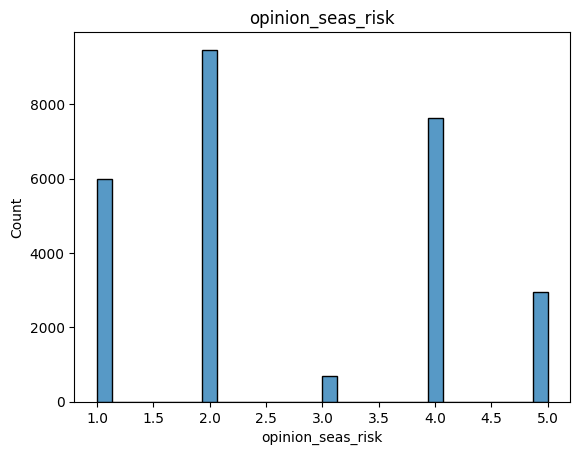

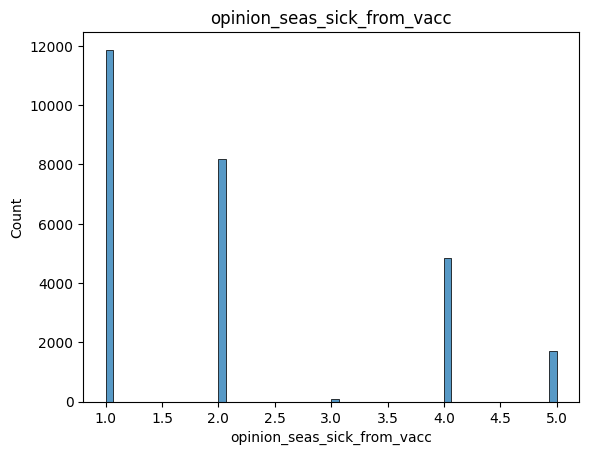

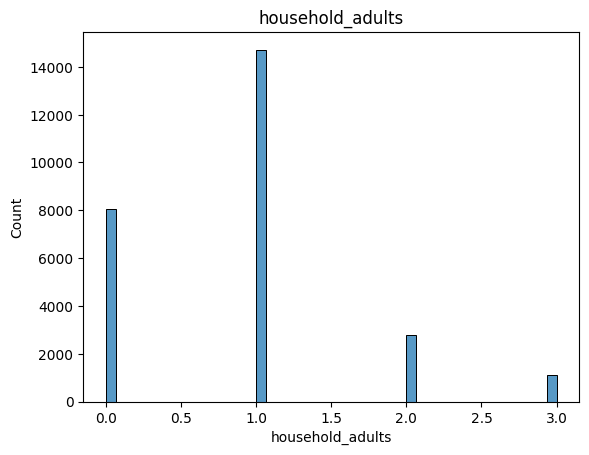

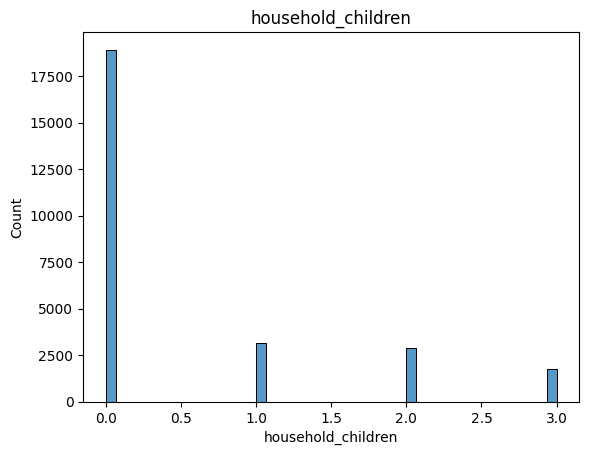

In [50]:
for i in missing_num:
    plt.figure()
    sns.histplot(x = i, data = missing_num)
    plt.title(i)

melihat visualisasi histogram saya memilih handling missing value dengan menggunakan simple imputer modus karena melihat grafik yang ada cukup stabil dan untuk data yang ada dikarena kan data terbut bernilai float yang sebenarnya biner, menggunakan modus sangat cocok untuk mengatasi ini

In [51]:
df1.shape

(26707, 35)

In [52]:
df_no_missing.head()

,respondent_id,h1n1_vaccine,seasonal_vaccine
0,0,0,0
1,1,0,1
2,2,0,0
3,3,0,1
4,4,0,0


In [53]:
data_numeric = pd.concat([num_missing_new_1, df_no_missing], axis=1)

In [54]:
#gabungkan 2 data yang sudah dihandling tadi
df_new = pd.concat([data_numeric, categorical_data],axis=1)
df_new.shape

(26707, 35)

In [55]:
df_new.head()

,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children,respondent_id,h1n1_vaccine,seasonal_vaccine,age_group,education,race,sex,income_poverty,marital_status,rent_or_own,employment_status,hhs_geo_region,census_msa
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,2.0,2.0,1.0,2.0,0.0,0.0,0,0,0,55 - 64 Years,< 12 Years,White,Female,Below Poverty,Not Married,Own,Not in Labor Force,oxchjgsf,Non-MSA
1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,5.0,4.0,4.0,4.0,2.0,4.0,0.0,0.0,1,0,1,35 - 44 Years,12 Years,White,Male,Below Poverty,Not Married,Rent,Employed,bhuqouqj,"MSA, Not Principle City"
2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0,1.0,1.0,4.0,1.0,2.0,2.0,0.0,2,0,0,18 - 34 Years,College Graduate,White,Male,"<= $75,000, Above Poverty",Not Married,Own,Employed,qufhixun,"MSA, Not Principle City"
3,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,3.0,3.0,5.0,5.0,4.0,1.0,0.0,0.0,3,0,1,65+ Years,12 Years,White,Female,Below Poverty,Not Married,Rent,Not in Labor Force,lrircsnp,"MSA, Principle City"
4,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,3.0,2.0,3.0,1.0,4.0,1.0,0.0,4,0,0,45 - 54 Years,Some College,White,Female,"<= $75,000, Above Poverty",Married,Own,Employed,qufhixun,"MSA, Not Principle City"


### 3.2 One Hot Encoding

In [56]:
categorical_data.head()

,age_group,education,race,sex,income_poverty,marital_status,rent_or_own,employment_status,hhs_geo_region,census_msa
0,55 - 64 Years,< 12 Years,White,Female,Below Poverty,Not Married,Own,Not in Labor Force,oxchjgsf,Non-MSA
1,35 - 44 Years,12 Years,White,Male,Below Poverty,Not Married,Rent,Employed,bhuqouqj,"MSA, Not Principle City"
2,18 - 34 Years,College Graduate,White,Male,"<= $75,000, Above Poverty",Not Married,Own,Employed,qufhixun,"MSA, Not Principle City"
3,65+ Years,12 Years,White,Female,Below Poverty,Not Married,Rent,Not in Labor Force,lrircsnp,"MSA, Principle City"
4,45 - 54 Years,Some College,White,Female,"<= $75,000, Above Poverty",Married,Own,Employed,qufhixun,"MSA, Not Principle City"


In [57]:
categorical_data['census_msa'].unique()

array(['Non-MSA', 'MSA, Not Principle  City', 'MSA, Principle City'],
      dtype=object)

In [58]:
df_new = pd.get_dummies(df_new, columns=['race', 'rent_or_own', 'employment_status','census_msa', 'marital_status', 'hhs_geo_region', 'census_msa'])

In [59]:
from sklearn import preprocessing

# label_encoder object knows how to understand word labels.
label_encoder = preprocessing.LabelEncoder()
df_new['age_group']= label_encoder.fit_transform(df_new['age_group'])
df_new['education']= label_encoder.fit_transform(df_new['education'])
df_new['sex']= label_encoder.fit_transform(df_new['sex'])
df_new['income_poverty']= label_encoder.fit_transform(df_new['income_poverty'])

In [60]:
df_new.shape

(26707, 56)

In [61]:
df_new.head()

,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children,respondent_id,h1n1_vaccine,seasonal_vaccine,age_group,education,sex,income_poverty,race_Black,race_Hispanic,race_Other or Multiple,race_White,rent_or_own_Own,rent_or_own_Rent,employment_status_Employed,employment_status_Not in Labor Force,employment_status_Unemployed,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA,marital_status_Married,marital_status_Not Married,hhs_geo_region_atmpeygn,hhs_geo_region_bhuqouqj,hhs_geo_region_dqpwygqj,hhs_geo_region_fpwskwrf,hhs_geo_region_kbazzjca,hhs_geo_region_lrircsnp,hhs_geo_region_lzgpxyit,hhs_geo_region_mlyzmhmf,hhs_geo_region_oxchjgsf,hhs_geo_region_qufhixun,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,2.0,2.0,1.0,2.0,0.0,0.0,0,0,0,3,1,0,2,0,0,0,1,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1
1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,5.0,4.0,4.0,4.0,2.0,4.0,0.0,0.0,1,0,1,1,0,1,2,0,0,0,1,0,1,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0
2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0,1.0,1.0,4.0,1.0,2.0,2.0,0.0,2,0,0,0,2,1,0,0,0,0,1,1,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0
3,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,3.0,3.0,5.0,5.0,4.0,1.0,0.0,0.0,3,0,1,4,0,0,2,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0
4,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,3.0,2.0,3.0,1.0,4.0,1.0,0.0,4,0,0,2,3,0,0,0,0,0,1,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0


In [62]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26707 entries, 0 to 26706
Data columns (total 56 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   h1n1_concern                          26707 non-null  float64
 1   h1n1_knowledge                        26707 non-null  float64
 2   behavioral_antiviral_meds             26707 non-null  float64
 3   behavioral_avoidance                  26707 non-null  float64
 4   behavioral_face_mask                  26707 non-null  float64
 5   behavioral_wash_hands                 26707 non-null  float64
 6   behavioral_large_gatherings           26707 non-null  float64
 7   behavioral_outside_home               26707 non-null  float64
 8   behavioral_touch_face                 26707 non-null  float64
 9   doctor_recc_h1n1                      26707 non-null  float64
 10  doctor_recc_seasonal                  26707 non-null  float64
 11  chronic_med_con

### 3.3 Handling Oversampling Target

In [63]:
df_new.head(2)

,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children,respondent_id,h1n1_vaccine,seasonal_vaccine,age_group,education,sex,income_poverty,race_Black,race_Hispanic,race_Other or Multiple,race_White,rent_or_own_Own,rent_or_own_Rent,employment_status_Employed,employment_status_Not in Labor Force,employment_status_Unemployed,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA,marital_status_Married,marital_status_Not Married,hhs_geo_region_atmpeygn,hhs_geo_region_bhuqouqj,hhs_geo_region_dqpwygqj,hhs_geo_region_fpwskwrf,hhs_geo_region_kbazzjca,hhs_geo_region_lrircsnp,hhs_geo_region_lzgpxyit,hhs_geo_region_mlyzmhmf,hhs_geo_region_oxchjgsf,hhs_geo_region_qufhixun,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,2.0,2.0,1.0,2.0,0.0,0.0,0,0,0,3,1,0,2,0,0,0,1,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1
1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,5.0,4.0,4.0,4.0,2.0,4.0,0.0,0.0,1,0,1,1,0,1,2,0,0,0,1,0,1,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0


In [64]:
df_new['h1n1_vaccine'].value_counts()

0    21033
1     5674
Name: h1n1_vaccine, dtype: int64

karena nilai target yang tidak seimbang kita perlu seimbangkan terlebih dahulu menggunakan package dari scikit-learn

In [65]:
from sklearn.utils import resample

#create two different dataframe of majority and minority class 
df_majority = df_new[(df_new['h1n1_vaccine']==0)] 
df_minority = df_new[(df_new['h1n1_vaccine']==1)] 
# upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,    # sample with replacement
                                 n_samples= 21000, # to match majority class
                                 random_state=20)  # reproducible results
# Combine majority class with upsampled minority class
df_update1 = df_upsampled = pd.concat([df_minority_upsampled, df_majority])

In [66]:
df_update1.dtypes

h1n1_concern                            float64
h1n1_knowledge                          float64
behavioral_antiviral_meds               float64
behavioral_avoidance                    float64
behavioral_face_mask                    float64
behavioral_wash_hands                   float64
behavioral_large_gatherings             float64
behavioral_outside_home                 float64
behavioral_touch_face                   float64
doctor_recc_h1n1                        float64
doctor_recc_seasonal                    float64
chronic_med_condition                   float64
child_under_6_months                    float64
health_worker                           float64
opinion_h1n1_vacc_effective             float64
opinion_h1n1_risk                       float64
opinion_h1n1_sick_from_vacc             float64
opinion_seas_vacc_effective             float64
opinion_seas_risk                       float64
opinion_seas_sick_from_vacc             float64
household_adults                        

In [67]:
fig = px.pie(df_update1, names='h1n1_vaccine',)
fig.update_layout(title='Persentase dari TARGET')
fig.show()

Nilai target yang tersedia telah seimbang

In [68]:
df_update1.isnull().sum()

h1n1_concern                            0
h1n1_knowledge                          0
behavioral_antiviral_meds               0
behavioral_avoidance                    0
behavioral_face_mask                    0
behavioral_wash_hands                   0
behavioral_large_gatherings             0
behavioral_outside_home                 0
behavioral_touch_face                   0
doctor_recc_h1n1                        0
doctor_recc_seasonal                    0
chronic_med_condition                   0
child_under_6_months                    0
health_worker                           0
opinion_h1n1_vacc_effective             0
opinion_h1n1_risk                       0
opinion_h1n1_sick_from_vacc             0
opinion_seas_vacc_effective             0
opinion_seas_risk                       0
opinion_seas_sick_from_vacc             0
household_adults                        0
household_children                      0
respondent_id                           0
h1n1_vaccine                      

### 3.4 Feature Selection

In [69]:
df_update1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42033 entries, 11721 to 26706
Data columns (total 56 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   h1n1_concern                          42033 non-null  float64
 1   h1n1_knowledge                        42033 non-null  float64
 2   behavioral_antiviral_meds             42033 non-null  float64
 3   behavioral_avoidance                  42033 non-null  float64
 4   behavioral_face_mask                  42033 non-null  float64
 5   behavioral_wash_hands                 42033 non-null  float64
 6   behavioral_large_gatherings           42033 non-null  float64
 7   behavioral_outside_home               42033 non-null  float64
 8   behavioral_touch_face                 42033 non-null  float64
 9   doctor_recc_h1n1                      42033 non-null  float64
 10  doctor_recc_seasonal                  42033 non-null  float64
 11  chronic_med

In [70]:
df_update1 = df_update1.drop('respondent_id', axis=1)

Menghapus kolom responden id yang tidak mempengarahui nilai target

In [71]:
df_seasonal_vaccine = df_update1.copy()

In [72]:
df_seasonal_vaccine.head()

,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children,h1n1_vaccine,seasonal_vaccine,age_group,education,sex,income_poverty,race_Black,race_Hispanic,race_Other or Multiple,race_White,rent_or_own_Own,rent_or_own_Rent,employment_status_Employed,employment_status_Not in Labor Force,employment_status_Unemployed,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA,marital_status_Married,marital_status_Not Married,hhs_geo_region_atmpeygn,hhs_geo_region_bhuqouqj,hhs_geo_region_dqpwygqj,hhs_geo_region_fpwskwrf,hhs_geo_region_kbazzjca,hhs_geo_region_lrircsnp,hhs_geo_region_lzgpxyit,hhs_geo_region_mlyzmhmf,hhs_geo_region_oxchjgsf,hhs_geo_region_qufhixun,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA
11721,3.0,2.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,5.0,5.0,1.0,5.0,4.0,1.0,1.0,1.0,1,1,3,2,0,1,0,0,0,1,1,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0
20560,3.0,2.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,4.0,5.0,4.0,4.0,5.0,0.0,0.0,1,1,2,2,1,0,0,1,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0
6644,2.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,4.0,4.0,2.0,4.0,4.0,4.0,1.0,0.0,1,1,2,2,1,0,0,0,0,1,0,1,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1
18440,1.0,2.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,5.0,5.0,2.0,5.0,5.0,2.0,1.0,1.0,1,1,1,3,0,0,0,0,0,1,1,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1
7404,2.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,5.0,2.0,2.0,5.0,2.0,4.0,2.0,0.0,1,1,3,2,1,1,0,0,0,1,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0


In [73]:
df_update1 = df_update1.drop('seasonal_vaccine', axis=1)

Mengapus kolom seasonal vaccine karena kolom ini tidak ada di test feature sebaiknya dihapus agar nanti nya tidak ada error pada test_feature

In [74]:
df_update1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 42033 entries, 11721 to 26706
Data columns (total 54 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   h1n1_concern                          42033 non-null  float64
 1   h1n1_knowledge                        42033 non-null  float64
 2   behavioral_antiviral_meds             42033 non-null  float64
 3   behavioral_avoidance                  42033 non-null  float64
 4   behavioral_face_mask                  42033 non-null  float64
 5   behavioral_wash_hands                 42033 non-null  float64
 6   behavioral_large_gatherings           42033 non-null  float64
 7   behavioral_outside_home               42033 non-null  float64
 8   behavioral_touch_face                 42033 non-null  float64
 9   doctor_recc_h1n1                      42033 non-null  float64
 10  doctor_recc_seasonal                  42033 non-null  float64
 11  chronic_med

In [75]:
X = df_update1.loc[:, df_update1.columns != 'h1n1_vaccine']
y = df_update1['h1n1_vaccine']

Memisahkan nilai target dengan nilai feature

In [76]:
# splitting X and y into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4,
                                                    random_state=0)

Memisahkan nilai training dengan nilai testing, dengan test_size 40% test dan 60% train

## Modeling H1N1 Vaccine

### 4.1 Logistic Regression

In [77]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()
lr = lr.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



### 4.2 Random Forest

In [78]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(random_state=42, n_jobs=-1, max_depth=5,
                                       n_estimators=100, oob_score=True)

rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=5, n_jobs=-1, oob_score=True, random_state=42)

In [79]:
rf = RandomForestClassifier(random_state=42, n_jobs=-1)

In [80]:
params = {
    'max_depth': [2,3,5,10,20],
    'min_samples_leaf': [5,10,20,50,100,200],
    'n_estimators': [10,25,30,50,100,200]
}

In [81]:
from sklearn.model_selection import GridSearchCV

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=rf,
                           param_grid=params,
                           cv = 4,
                           n_jobs=-1, verbose=1, scoring="accuracy")

grid_search.fit(X_train, y_train)

Fitting 4 folds for each of 180 candidates, totalling 720 fits


GridSearchCV(cv=4, estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100, 200],
                         'n_estimators': [10, 25, 30, 50, 100, 200]},
             scoring='accuracy', verbose=1)

In [82]:
grid_search.best_score_

0.8257661952986309

In [83]:
rf_best = grid_search.best_estimator_
rf_best.fit(X_train, y_train)

RandomForestClassifier(max_depth=20, min_samples_leaf=5, n_estimators=200,
                       n_jobs=-1, random_state=42)

In [84]:
pickle.dump(rf_best, open(root + 'model/random_forest2.pkl', 'wb'))

### 4.3 KNN

In [85]:
from sklearn.neighbors import KNeighborsClassifier

In [86]:
knn = KNeighborsClassifier(n_neighbors=7, weights='uniform', leaf_size=50, metric='minkowski')

In [ ]:
#knn_Grid = GridSearchCV(estimator = knn, param_grid = param_grid, cv = 3, scoring="roc_auc")

In [89]:
# Train the classifier
knn = knn.fit(X_train, y_train)

In [ ]:
#knn_Grid.fit(X_train.values,y_train.values.ravel())

In [ ]:
#knn_opt = knn_Grid.best_estimator_

In [90]:
y_train.head(2)

9800    0
3072    0
Name: h1n1_vaccine, dtype: int64

In [133]:
pickle.dump(knn, open(root + 'model/KNN_Model_6.pkl', 'wb'))

Dengan hasil evaluasi yang diberikan model knn memiliki hasil yang lebih baik, maka dari itu model knn akan kami simpan dan akan dilakukan mengetesan pada test_feature

### 4.4 XGBosst

In [92]:
import xgboost as xgb
from xgboost import XGBClassifier

In [93]:
n = int(len(X_train)*0.8)

In [94]:
X_train_fit, X_train_eval, y_train_fit, y_train_eval = X_train[:n], X_train[n:], y_train[:n], y_train[n:]

## Evaluation

In [135]:
X_train.shape

(25219, 53)

In [95]:
y_lr = lr.predict(X_test)
y_rf = rf_best.predict(X_test)
y_knn = knn.predict(X_test)


In [96]:
y_knn = knn.predict(X_test)

In [97]:
from sklearn.metrics import accuracy_score
print("Accurracy with LR :", accuracy_score(y_test, y_lr))
print("Accurracy with RF :", accuracy_score(y_test, y_rf))
print("Accurracy with KNN :", accuracy_score(y_test, y_knn))

Accurracy with LR : 0.7619245866539788
Accurracy with RF : 0.8376947781610563
Accurracy with KNN : 0.7536576662305222


### 5.2 Precission

In [98]:
from sklearn.metrics import precision_score
print("Precision with LR :", precision_score(y_test, y_lr, average='macro'))
print("Precision with RF :", precision_score(y_test, y_rf, average='macro'))
print("Precision with KNN :", precision_score(y_test, y_knn, average='macro'))

Precision with LR : 0.7629524380292751
Precision with RF : 0.8377123276527159
Precision with KNN : 0.7545430647732707


### 5.3 Recall

In [99]:
from sklearn.metrics import recall_score
print("Recall score with LR :", recall_score(y_test, y_lr, average='macro'))
print("Recall score with RF :", recall_score(y_test, y_rf, average='macro'))
print("Recall score with KNN :", recall_score(y_test, y_knn, average='macro'))

Recall score with LR : 0.7617746122141835
Recall score with RF : 0.8376755585704978
Recall score with KNN : 0.753789766185267


### 5.4 Confusion Matrix

In [100]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test, y_lr))
print("---------------")
print(confusion_matrix(y_test, y_rf))
print("---------------")
print(confusion_matrix(y_test, y_knn))

[[6707 1739]
 [2264 6104]]
---------------
[[7110 1336]
 [1393 6975]]
---------------
[[6126 2320]
 [1822 6546]]


### 5.5 Classification Report

In [101]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_lr))
print("=======================================================")
print(classification_report(y_test, y_rf))

print("=======================================================")
print(classification_report(y_test, y_knn))

              precision    recall  f1-score   support

           0       0.75      0.79      0.77      8446
           1       0.78      0.73      0.75      8368

    accuracy                           0.76     16814
   macro avg       0.76      0.76      0.76     16814
weighted avg       0.76      0.76      0.76     16814

              precision    recall  f1-score   support

           0       0.84      0.84      0.84      8446
           1       0.84      0.83      0.84      8368

    accuracy                           0.84     16814
   macro avg       0.84      0.84      0.84     16814
weighted avg       0.84      0.84      0.84     16814

              precision    recall  f1-score   support

           0       0.77      0.73      0.75      8446
           1       0.74      0.78      0.76      8368

    accuracy                           0.75     16814
   macro avg       0.75      0.75      0.75     16814
weighted avg       0.75      0.75      0.75     16814



### 5.6 ROC AND AUC

In [102]:
from sklearn.metrics import roc_curve, auc
fpr, tpr, thresholds = roc_curve(y_test, y_lr, pos_label=1) # pos_label: positive label
print(auc(fpr, tpr))
print("-----------------")
fpr, tpr, thresholds = roc_curve(y_test, y_rf, pos_label=1) # pos_label: positive label
print(auc(fpr, tpr))
print("-----------------")
fpr, tpr, thresholds = roc_curve(y_test, y_knn, pos_label=1) # pos_label: positive label
print(auc(fpr, tpr))

0.7617746122141835
-----------------
0.8376755585704978
-----------------
0.753789766185267


## Modeling Seasonal vaccine

Splitting Train Test

In [103]:
df_seasonal_vaccine.head()

,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children,h1n1_vaccine,seasonal_vaccine,age_group,education,sex,income_poverty,race_Black,race_Hispanic,race_Other or Multiple,race_White,rent_or_own_Own,rent_or_own_Rent,employment_status_Employed,employment_status_Not in Labor Force,employment_status_Unemployed,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA,marital_status_Married,marital_status_Not Married,hhs_geo_region_atmpeygn,hhs_geo_region_bhuqouqj,hhs_geo_region_dqpwygqj,hhs_geo_region_fpwskwrf,hhs_geo_region_kbazzjca,hhs_geo_region_lrircsnp,hhs_geo_region_lzgpxyit,hhs_geo_region_mlyzmhmf,hhs_geo_region_oxchjgsf,hhs_geo_region_qufhixun,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA
11721,3.0,2.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,5.0,5.0,1.0,5.0,4.0,1.0,1.0,1.0,1,1,3,2,0,1,0,0,0,1,1,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0
20560,3.0,2.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,4.0,5.0,4.0,4.0,5.0,0.0,0.0,1,1,2,2,1,0,0,1,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0
6644,2.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,4.0,4.0,2.0,4.0,4.0,4.0,1.0,0.0,1,1,2,2,1,0,0,0,0,1,0,1,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1
18440,1.0,2.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,5.0,5.0,2.0,5.0,5.0,2.0,1.0,1.0,1,1,1,3,0,0,0,0,0,1,1,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1
7404,2.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,5.0,2.0,2.0,5.0,2.0,4.0,2.0,0.0,1,1,3,2,1,1,0,0,0,1,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0


In [105]:
df_seasonal_vaccine['seasonal_vaccine'].value_counts()

1    25163
0    16870
Name: seasonal_vaccine, dtype: int64

In [107]:
fig = px.pie(df_seasonal_vaccine, names='seasonal_vaccine',)
fig.update_layout(title='Persentase dari TARGET')
fig.show()

Distribusi cukup seimbang jadi tidak perlu untuk menatasi oversampling lagi.

In [108]:
df_seasonal_vaccine = df_seasonal_vaccine.drop('h1n1_vaccine', axis=1)

In [109]:
X = df_seasonal_vaccine.loc[:, df_seasonal_vaccine.columns != 'seasonal_vaccine']
y = df_seasonal_vaccine['seasonal_vaccine']

In [110]:
# splitting X and y into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4,
                                                    random_state=0)

### 4.1 Logistic Regression

In [111]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()
lr = lr.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



### 4.2 Random Forest

In [112]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(random_state=42, n_jobs=-1, max_depth=5,
                                       n_estimators=100, oob_score=True)

rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=5, n_jobs=-1, oob_score=True, random_state=42)

In [113]:
rf = RandomForestClassifier(random_state=42, n_jobs=-1)

In [114]:
params = {
    'max_depth': [2,3,5,10,20],
    'min_samples_leaf': [5,10,20,50,100,200],
    'n_estimators': [10,25,30,50,100,200]
}

In [115]:
from sklearn.model_selection import GridSearchCV

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=rf,
                           param_grid=params,
                           cv = 4,
                           n_jobs=-1, verbose=1, scoring="accuracy")

grid_search.fit(X_train, y_train)

Fitting 4 folds for each of 180 candidates, totalling 720 fits


GridSearchCV(cv=4, estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100, 200],
                         'n_estimators': [10, 25, 30, 50, 100, 200]},
             scoring='accuracy', verbose=1)

In [116]:
grid_search.best_score_

0.8327844851097147

In [117]:
rf_best = grid_search.best_estimator_
rf_best.fit(X_train, y_train)

RandomForestClassifier(max_depth=20, min_samples_leaf=5, n_estimators=50,
                       n_jobs=-1, random_state=42)

### 4.3 KNN

In [118]:
from sklearn.neighbors import KNeighborsClassifier

In [119]:
knn = KNeighborsClassifier(n_neighbors=7, weights='uniform', leaf_size=50, metric='minkowski')

In [120]:
# Train the classifier
knn = knn.fit(X_train, y_train)

In [121]:
X_train.head()

,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,doctor_recc_seasonal,chronic_med_condition,child_under_6_months,health_worker,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children,age_group,education,sex,income_poverty,race_Black,race_Hispanic,race_Other or Multiple,race_White,rent_or_own_Own,rent_or_own_Rent,employment_status_Employed,employment_status_Not in Labor Force,employment_status_Unemployed,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA,marital_status_Married,marital_status_Not Married,hhs_geo_region_atmpeygn,hhs_geo_region_bhuqouqj,hhs_geo_region_dqpwygqj,hhs_geo_region_fpwskwrf,hhs_geo_region_kbazzjca,hhs_geo_region_lrircsnp,hhs_geo_region_lzgpxyit,hhs_geo_region_mlyzmhmf,hhs_geo_region_oxchjgsf,hhs_geo_region_qufhixun,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA
9800,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,2.0,2.0,4.0,4.0,2.0,1.0,0.0,3,2,1,0,0,0,0,1,1,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1,0
3072,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,2.0,2.0,4.0,2.0,2.0,1.0,2.0,1,0,1,0,0,0,0,1,1,0,1,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1
10757,1.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,4.0,2.0,2.0,5.0,2.0,2.0,1.0,0.0,2,3,1,0,0,0,0,1,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0
3041,2.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,1.0,4.0,1.0,4.0,0.0,0.0,3,2,0,0,0,0,0,1,1,0,1,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1
11949,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,1.0,1.0,5.0,1.0,1.0,1.0,0.0,0,3,1,0,0,0,0,1,0,1,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0


In [122]:
pickle.dump(knn, open(root + 'model/KNN_Model_sc2.pkl', 'wb'))

### 4.4 XGBosst

In [123]:
import xgboost as xgb
from xgboost import XGBClassifier

In [124]:
n = int(len(X_train)*0.8)

In [125]:
X_train_fit, X_train_eval, y_train_fit, y_train_eval = X_train[:n], X_train[n:], y_train[:n], y_train[n:]

## Evaluation

In [126]:
y_lr = lr.predict(X_test)
y_rf = rf_best.predict(X_test)
y_knn = knn.predict(X_test)


### 5.1 Accuracy

In [127]:
from sklearn.metrics import accuracy_score
print("Accurracy with LR :", accuracy_score(y_test, y_lr))
print("Accurracy with RF :", accuracy_score(y_test, y_rf))
print("Accurracy with KNN :", accuracy_score(y_test, y_knn))

Accurracy with LR : 0.7775663137861306
Accurracy with RF : 0.8357916022362317
Accurracy with KNN : 0.7739978589270846


### 5.2 Precission

In [128]:
from sklearn.metrics import precision_score
print("Precision with LR :", precision_score(y_test, y_lr, average='macro'))
print("Precision with RF :", precision_score(y_test, y_rf, average='macro'))
print("Precision with KNN :", precision_score(y_test, y_knn, average='macro'))

Precision with LR : 0.769541051374037
Precision with RF : 0.8323406886056687
Precision with KNN : 0.7663279235996614


### 5.3 Recall

In [129]:
from sklearn.metrics import recall_score
print("Recall score with LR :", recall_score(y_test, y_lr, average='macro'))
print("Recall score with RF :", recall_score(y_test, y_rf, average='macro'))
print("Recall score with KNN :", recall_score(y_test, y_knn, average='macro'))

Recall score with LR : 0.7650886413834753
Recall score with RF : 0.82366242502947
Recall score with KNN : 0.7596528079236365


### 5.4 Confusion Matrix

In [130]:
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test, y_lr))
print("---------------")
print(confusion_matrix(y_test, y_rf))
print("---------------")
print(confusion_matrix(y_test, y_knn))

[[4748 2027]
 [1713 8326]]
---------------
[[5157 1618]
 [1143 8896]]
---------------
[[4646 2129]
 [1671 8368]]


### 5.5 Classification Report

In [131]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_lr))
print("=======================================================")
print(classification_report(y_test, y_rf))

print("=======================================================")
print(classification_report(y_test, y_knn))

              precision    recall  f1-score   support

           0       0.73      0.70      0.72      6775
           1       0.80      0.83      0.82     10039

    accuracy                           0.78     16814
   macro avg       0.77      0.77      0.77     16814
weighted avg       0.78      0.78      0.78     16814

              precision    recall  f1-score   support

           0       0.82      0.76      0.79      6775
           1       0.85      0.89      0.87     10039

    accuracy                           0.84     16814
   macro avg       0.83      0.82      0.83     16814
weighted avg       0.84      0.84      0.83     16814

              precision    recall  f1-score   support

           0       0.74      0.69      0.71      6775
           1       0.80      0.83      0.81     10039

    accuracy                           0.77     16814
   macro avg       0.77      0.76      0.76     16814
weighted avg       0.77      0.77      0.77     16814



### 5.6 ROC AND AUC

In [132]:
from sklearn.metrics import roc_curve, auc
fpr, tpr, thresholds = roc_curve(y_test, y_lr, pos_label=1) # pos_label: positive label
print(auc(fpr, tpr))
print("-----------------")
fpr, tpr, thresholds = roc_curve(y_test, y_rf, pos_label=1) # pos_label: positive label
print(auc(fpr, tpr))
print("-----------------")
fpr, tpr, thresholds = roc_curve(y_test, y_knn, pos_label=1) # pos_label: positive label
print(auc(fpr, tpr))

0.7650886413834753
-----------------
0.8236624250294698
-----------------
0.7596528079236365


### Conclusion

Kesimpulan yang dapat diambil adalah melihat dari hasil evaluasi yang ditampilkan kita akan menggunakan KNN, karena hasil yang diberikan lebih bagus dibandingkan model lainnya.